In [1]:
# to install the correct version of pytorch for this CUDA device:
# conda install pytorch torchvision torchaudio cudatoolkit=11.1 -c pytorch -c nvidia
#
# scvi-tools was installed using the conda instructions on the scvi website
# scanpy was installed using the conda instructions on the scanpy website

import scvi
import torch
import scanpy as sc
import anndata
from scipy import io
from scipy.sparse import coo_matrix, csr_matrix
import numpy as np
import seaborn as sns
from matplotlib import pyplot as plt
import os
import pandas as pd
# import skmisc

sc.settings.set_figure_params(dpi=300, figsize=(4,4), facecolor='white')
torch.cuda.is_available()


Global seed set to 0


True

In [2]:
os.chdir('/dfs7/swaruplab/smorabit/analysis/ADDS_2021/splitseq/integration/')
data_dir = 'data/'
fig_dir = 'figures/'

In [5]:
# re-load the final dataset
adata = sc.read_h5ad('{}ADDS_subclusters_final.h5ad'.format(data_dir))

In [6]:
adata

AnnData object with n_obs × n_vars = 585404 × 3000
    obs: 'orig_barcode', 'n_counts', 'doublet_scores', 'Sample', 'Diagnosis', 'Study', 'Batch', 'Age', 'Sex', 'PMI', 'braaksc', 'cell_type', 'annotation', 'Tissue', 'Chemistry', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'labels_scanvi', '_scvi_batch', '_scvi_labels', 'predictions', 'batch', 'cell_identity', 'UMAP_1', 'UMAP_2'
    var: 'mt', 'ensembl_id-0-0-0', 'gene_name-0', 'n_cells_by_counts-0', 'mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'n_counts-0', 'highly_variable-0', 'highly_variable_rank-0', 'means-0', 'variances-0', 'variances_norm-0', 'highly_variable_nbatches-0', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'highly_variable-1', 'means-1', 'gene_ids-1', 'log1p_mean_counts-1', 'log1p_total_counts-1', 'dispersions-1', 'dispersions_norm-1', 'mean-1', 'std-1', 'n_cells_by_counts-2', 'mean_counts-2', 'pct_dropout_by_counts-2', 'total_counts-2

## Subclustering analysis

In [5]:
adata = sc.read_h5ad('{}ADDS_AD_integrated.h5ad'.format(data_dir))

In [118]:
adata.obs.Study.value_counts()

ADDS           396277
Zhou_2020       82366
Morabito        57856
Mathys_2019     48905
Name: Study, dtype: int64

In [119]:
adata.obs[adata.obs.Study == 'Mathys_2019'].head()

,orig_barcode,n_counts,doublet_scores,Sample,Diagnosis,Study,Batch,Age,Sex,PMI,...,total_counts_mt,pct_counts_mt,labels_scanvi,_scvi_batch,_scvi_labels,predictions,batch,cell_identity,UMAP_1,UMAP_2
CGCGTTTGTGATGCCC-0-2,CGCGTTTGTGATGCCC,29271.0,0.128205,Mathys_2019_D17-8758,Alzheimer Disease,Mathys_2019,Mathys_2019,74.773443,F,5.083333,...,NaN,NaN,Unknown,8,22,EX L6,2,EX L6,12.850935,7.174314
CCGGTAGGTATGCTTG-0-2,CCGGTAGGTATGCTTG,28540.0,0.128205,Mathys_2019_D17-8758,Alzheimer Disease,Mathys_2019,Mathys_2019,74.773443,F,5.083333,...,NaN,NaN,Unknown,8,22,INH PVALB+,2,INH PVALB+,5.358170,17.493378
ACTGTCCGTGCCTGTG-0-2,ACTGTCCGTGCCTGTG,28395.0,0.173145,Mathys_2019_D17-8758,Alzheimer Disease,Mathys_2019,Mathys_2019,74.773443,F,5.083333,...,NaN,NaN,Unknown,8,22,EX L3-5,2,EX L3-5,10.349279,4.041228
CAGCCGATCACAGTAC-0-2,CAGCCGATCACAGTAC,28324.0,0.137725,Mathys_2019_D17-8758,Alzheimer Disease,Mathys_2019,Mathys_2019,74.773443,F,5.083333,...,NaN,NaN,Unknown,8,22,EX L6,2,EX L6,12.758555,7.229840
TGCACCTAGCCAGAAC-0-2,TGCACCTAGCCAGAAC,28243.0,0.119565,Mathys_2019_D17-8758,Alzheimer Disease,Mathys_2019,Mathys_2019,74.773443,F,5.083333,...,NaN,NaN,Unknown,8,22,INH VIP+,2,INH VIP+,13.166521,14.573036


In [5]:
# # set counts matrix for adata_adds
# adata_unf = sc.read_h5ad('/dfs7/swaruplab/smorabit/analysis/ADDS_2021/doublet_detection/data/ADDS_cellbender_scrublet_unfiltered.h5ad')


# adata_unf = adata_unf[adata_adds.obs.index]
# adata_unf.obs = adata_adds.obs
# adata_unf.layers['counts'] = adata_unf.X
# adata_adds = adata_unf
# del adata_unf


## OPC Subclustering:

Note: OPC didn't look very good so I did not continue doing this

1. Load data, perform pre-processing steps.

In [7]:
adata_opc = adata[adata.obs.cell_identity.isin(['OPC'])].copy()
adata_opc = adata_opc[adata_opc.obs.cell_type.isin(['OPC'])].copy()

In [8]:
# use scVI latent space for UMAP generation
sc.pp.neighbors(adata_opc, use_rep="X_scANVI", metric='cosine', n_neighbors=15)
sc.tl.umap(adata_opc, min_dist=0.2)

In [9]:
sc.tl.leiden(adata_opc, resolution = 0.1)
sc.tl.dendrogram(adata_opc, groupby="leiden", use_rep="X_scANVI")

In [10]:
# change annotaiton name
adata_opc.obs['annotation'] = ['OPC' + str(int(x) + 1) for x in adata_opc.obs.leiden.to_list()]

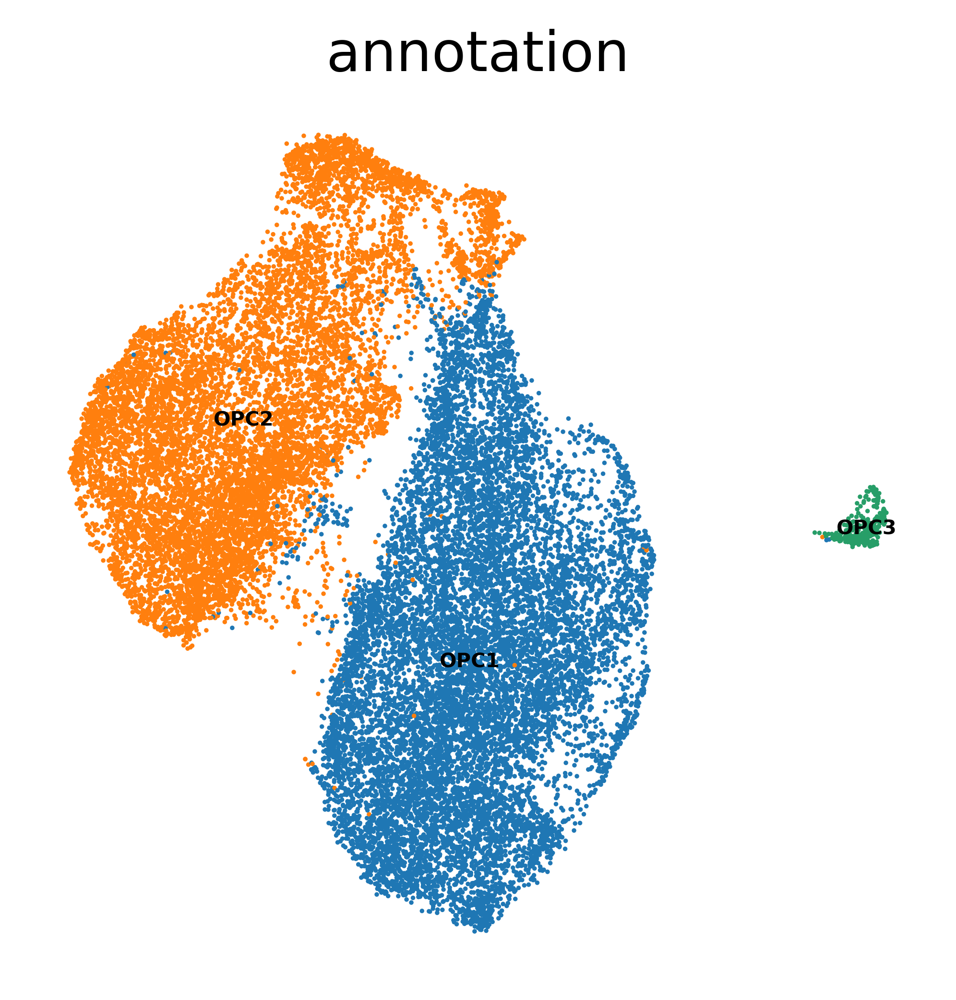

In [11]:
sc.settings.set_figure_params(dpi=300, figsize=(4,4), facecolor='white')
sc.pl.umap(
    adata_opc,
    color=["annotation"],
    frameon=False, 
    legend_fontsize=5, 
    legend_loc='on data', 
)


<AxesSubplot:title={'center':'ADDS'}, xlabel='UMAP1', ylabel='UMAP2'>

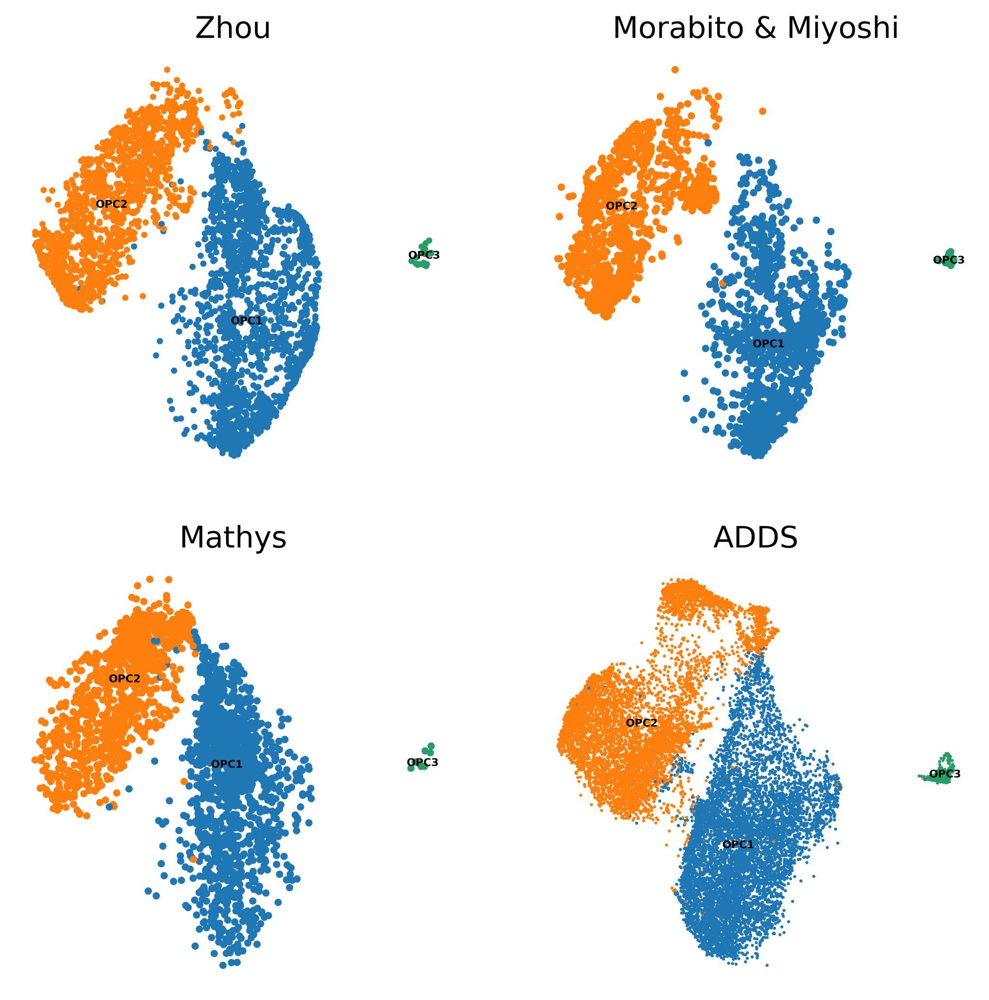

In [12]:
sc.settings.set_figure_params(dpi=300, figsize=(8,8), facecolor='white')


fig, axs = plt.subplots(2, 2)


f1 = sc.pl.umap(
    adata_opc[adata_opc.obs.Study == 'Zhou_2020'],
    color=["annotation"],
    frameon=False,
    legend_fontsize=5,
    legend_loc='on data',
    title = 'Zhou',
    ax = axs[0,0],
    show=False
)

sc.pl.umap(
    adata_opc[adata_opc.obs.Study == 'Morabito'],
    color=["annotation"],
    frameon=False,
    legend_fontsize=5,
    legend_loc='on data',
    title = 'Morabito & Miyoshi',
    ax = axs[0,1],
    show=False

)

sc.pl.umap(
    adata_opc[adata_opc.obs.Study == 'Mathys_2019'],
    color=["annotation"],
    frameon=False,
    legend_fontsize=5,
    legend_loc='on data',
    title = 'Mathys',
    ax = axs[1,0],
    show=False
)

sc.pl.umap(
    adata_opc[adata_opc.obs.Study == 'ADDS'],
    color=["annotation"],
    frameon=False,
    legend_fontsize=5,
    legend_loc='on data',
    title = 'ADDS',
    ax = axs[1,1],
    show=False
)




         Falling back to preprocessing with `sc.pp.pca` and default params.
categories: OPC1, OPC2, OPC3
var_group_labels: Oligodendrocyte, Oligodendrocyte Proge?nitor, COPs


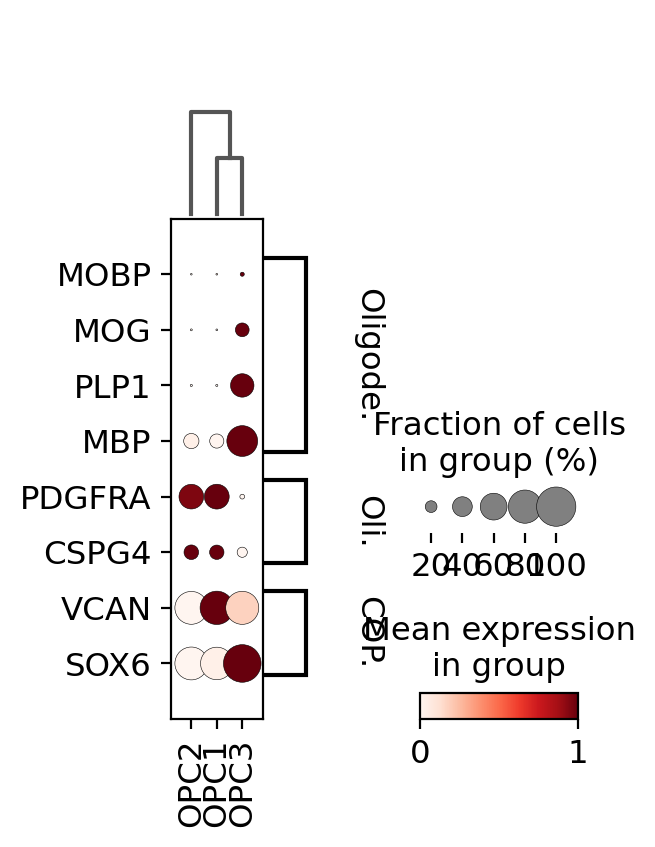

In [13]:
marker_dict = {
    'Oligodendrocyte': ['MOBP', 'MOG', 'PLP1', 'MBP'],
    'Oligodendrocyte Proge?nitor': ['PDGFRA', 'CSPG4'],
    'COPs': ['VCAN', 'SOX6',]
}

sc.set_figure_params(dpi=100)
sc.pl.dotplot(
    adata_opc[adata_opc.obs.Study == 'ADDS'], 
    marker_dict, 'annotation', 
    dendrogram=True, 
    use_raw=False, 
    standard_scale='var', 
    swap_axes=True
)


In [14]:
adata_opc.obs['UMAP_sub_1'] = adata_opc.obsm['X_umap'][:,0]
adata_opc.obs['UMAP_sub_2'] = adata_opc.obsm['X_umap'][:,1]
adata_opc.obs.to_csv('{}ADDS_OPC_subcluster_obs.tsv'.format(data_dir), sep='\t')


## ODC subclustering:

In [22]:
adata_odc = adata[adata.obs.cell_identity.isin(['ODC'])].copy()
adata_odc = adata_odc[adata_odc.obs.cell_type.isin(['ODC'])].copy()

In [23]:
adata_odc.obs.cell_identity.value_counts()

ODC    153300
Name: cell_identity, dtype: int64

In [24]:
# use scVI latent space for UMAP generation
sc.pp.neighbors(adata_odc, use_rep="X_scANVI", metric='cosine', n_neighbors=30)
sc.tl.umap(adata_odc, min_dist=0.2)


In [25]:
sc.tl.leiden(adata_odc, resolution = 0.15)
sc.tl.dendrogram(adata_odc, groupby="leiden", use_rep="X_scANVI")

In [26]:
# change annotaiton name
adata_odc.obs['annotation'] = ['ODC' + str(int(x) + 1) for x in adata_odc.obs.leiden.to_list()]

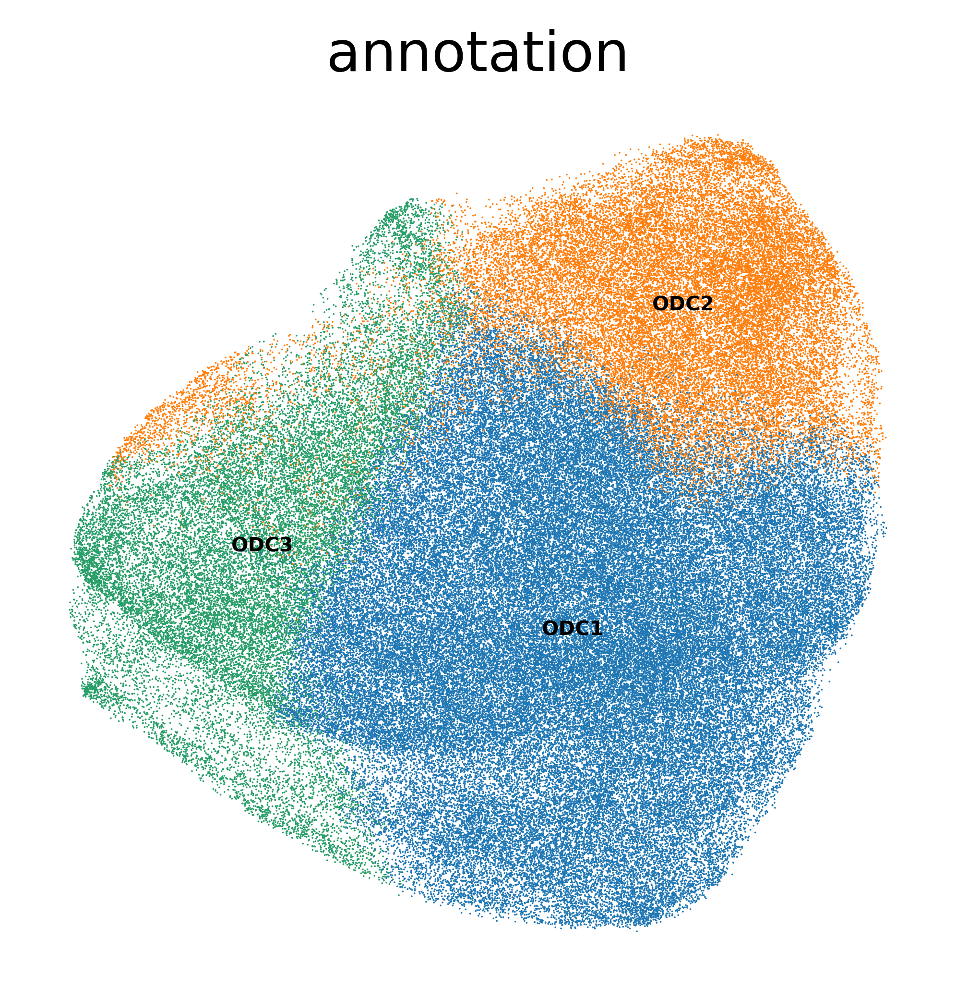

In [27]:
sc.settings.set_figure_params(dpi=300, figsize=(4,4), facecolor='white')
sc.pl.umap(
    adata_odc,
    color=["annotation"],
    frameon=False, 
    legend_fontsize=5, 
    legend_loc='on data', 
)


<AxesSubplot:title={'center':'ADDS'}, xlabel='UMAP1', ylabel='UMAP2'>

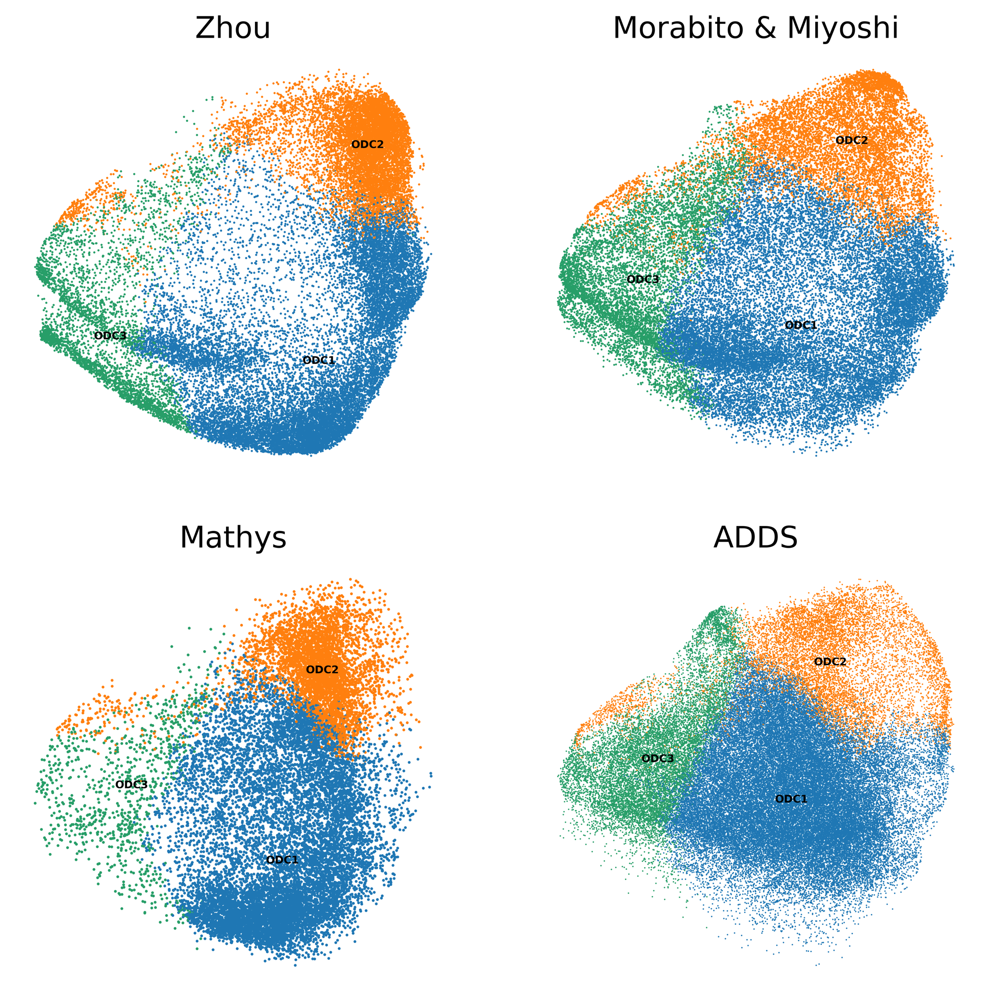

In [28]:
sc.settings.set_figure_params(dpi=300, figsize=(8,8), facecolor='white')


fig, axs = plt.subplots(2, 2)


f1 = sc.pl.umap(
    adata_odc[adata_odc.obs.Study == 'Zhou_2020'],
    color=["annotation"],
    frameon=False,
    legend_fontsize=5,
    legend_loc='on data',
    title = 'Zhou',
    ax = axs[0,0],
    show=False
)

sc.pl.umap(
    adata_odc[adata_odc.obs.Study == 'Morabito'],
    color=["annotation"],
    frameon=False,
    legend_fontsize=5,
    legend_loc='on data',
    title = 'Morabito & Miyoshi',
    ax = axs[0,1],
    show=False

)

sc.pl.umap(
    adata_odc[adata_odc.obs.Study == 'Mathys_2019'],
    color=["annotation"],
    frameon=False,
    legend_fontsize=5,
    legend_loc='on data',
    title = 'Mathys',
    ax = axs[1,0],
    show=False
)

sc.pl.umap(
        adata_odc[adata_odc.obs.Study == 'ADDS'],
    color=["annotation"],
    frameon=False,
    legend_fontsize=5,
    legend_loc='on data',
    title = 'ADDS',
    ax = axs[1,1],
    show=False
)




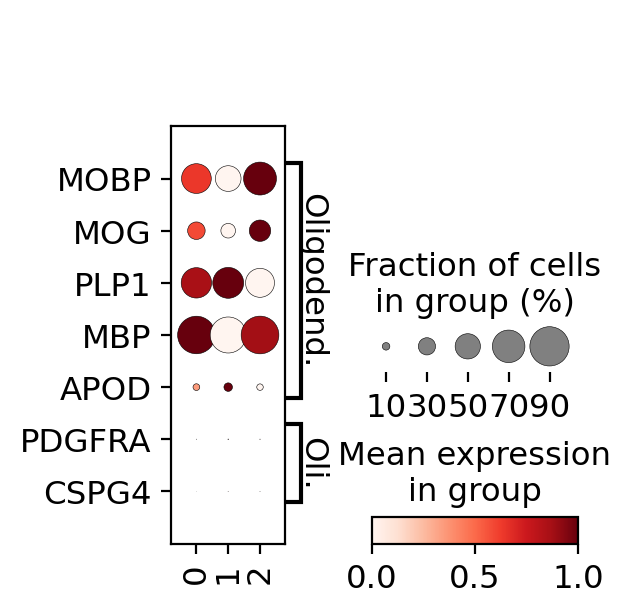

In [29]:
marker_dict = {
    'Oligodendrocyte': ['MOBP', 'MOG', 'PLP1', 'MBP', 'APOD'],
    'Oligodendrocyte Progenitor': ['PDGFRA', 'CSPG4']
}

sc.set_figure_params(dpi=100)
sc.pl.dotplot(adata_odc[adata_odc.obs.Study == 'ADDS'], marker_dict, 'leiden', dendrogram=False, use_raw=False, standard_scale='var', swap_axes=True)


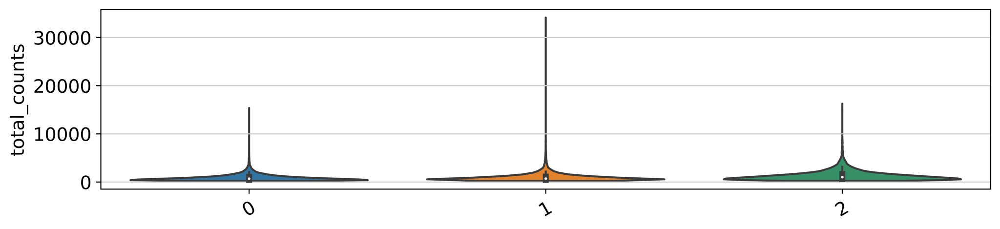

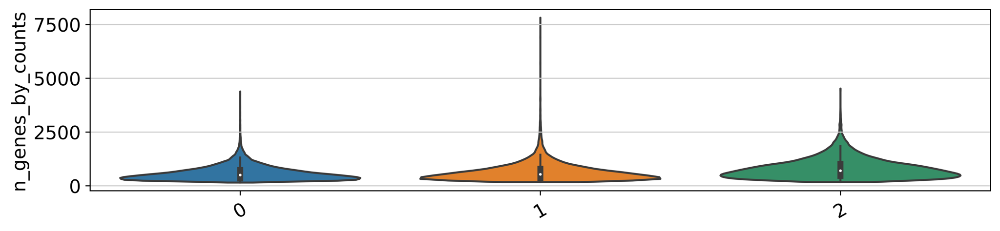

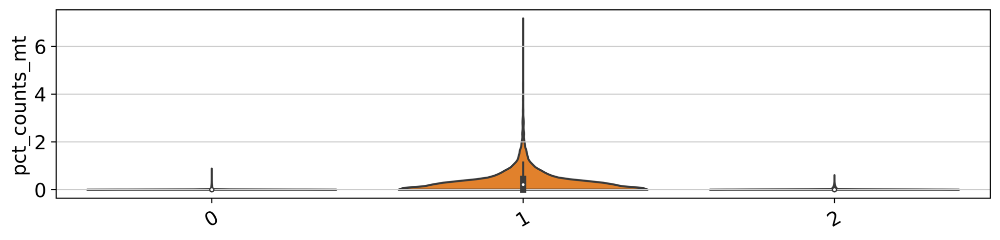

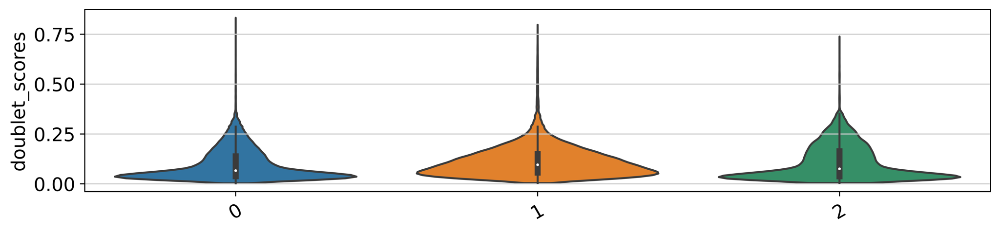

In [30]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(10,2.5), facecolor='white')
sc.pl.violin(adata_odc,[ 'total_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata_odc,[ 'n_genes_by_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata_odc,[ 'pct_counts_mt'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata_odc,[ 'doublet_scores'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)


<AxesSubplot:xlabel='UMAP_1', ylabel='UMAP_2'>

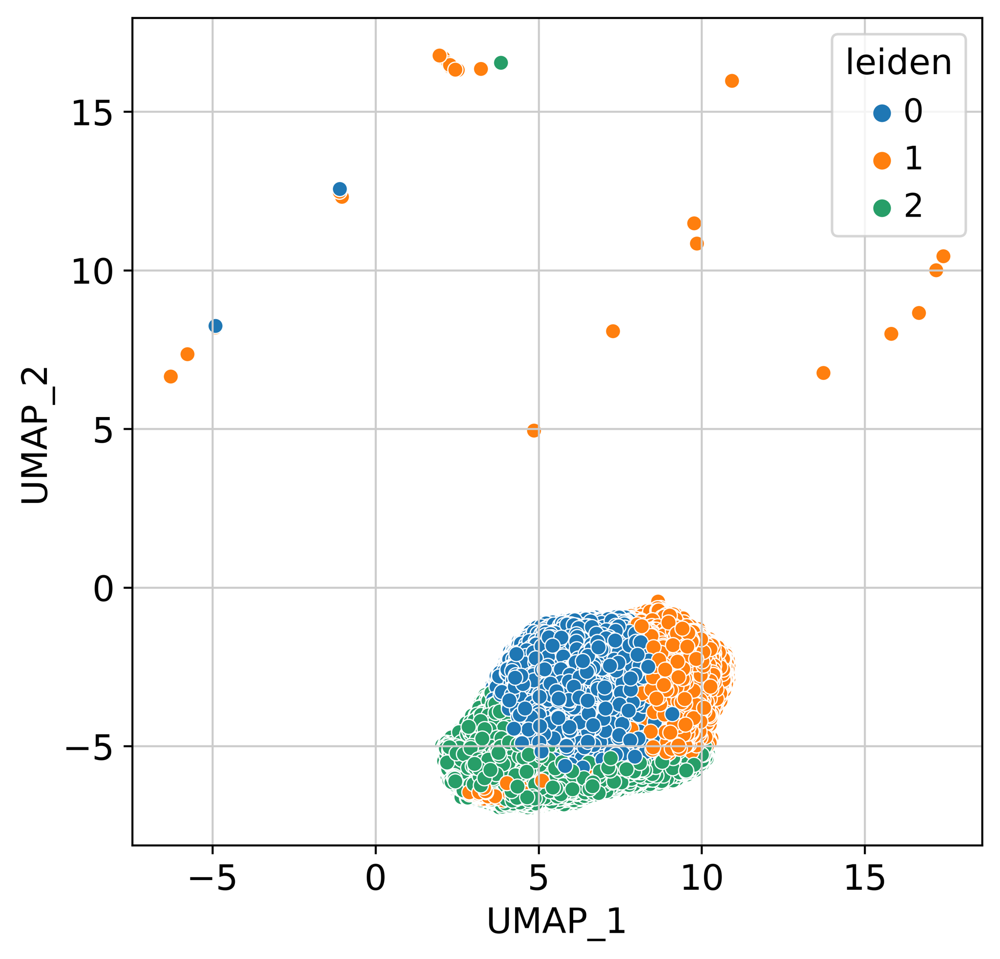

In [31]:
sc.settings.set_figure_params(dpi=300, figsize=(6,6), facecolor='white')

sns.scatterplot(
    data = adata_odc.obs,
    x = 'UMAP_1',
    y = 'UMAP_2',
    hue = 'leiden'
)

In [32]:
adata_odc.obs['UMAP_sub_1'] = adata_odc.obsm['X_umap'][:,0]
adata_odc.obs['UMAP_sub_2'] = adata_odc.obsm['X_umap'][:,1]
adata_odc.obs.to_csv('{}ADDS_ODC_subcluster_obs.tsv'.format(data_dir), sep='\t')

## ASC subclustering:

In [45]:
adata_asc = adata[adata.obs.cell_type == 'ASC'].copy()
adata_asc = adata_asc[adata_asc.obs.cell_identity == 'ASC'].copy()

In [46]:
# use scVI latent space for UMAP generation
sc.pp.neighbors(adata_asc, use_rep="X_scANVI", metric='cosine', n_neighbors=25)
sc.tl.umap(adata_asc, min_dist=0.01)


In [47]:
sc.tl.leiden(adata_asc, resolution = 0.25)
sc.tl.dendrogram(adata_asc, groupby="leiden", use_rep="X_scANVI")

In [48]:
# change annotaiton name
adata_asc.obs['annotation'] = ['ASC' + str(int(x) + 1) for x in adata_asc.obs.leiden.to_list()]

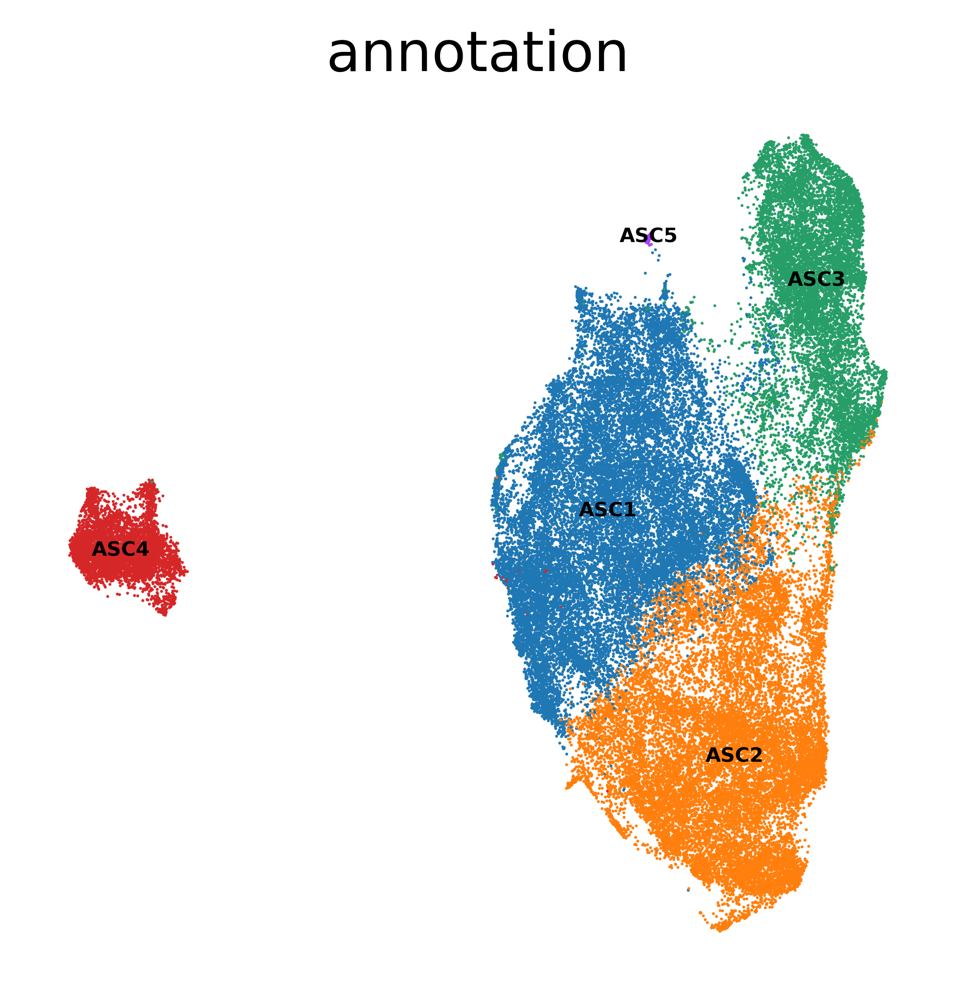

In [49]:
sc.settings.set_figure_params(dpi=300, figsize=(4,4), facecolor='white')

sc.pl.umap(
    adata_asc,
    color=["annotation"],
    frameon=False, 
    legend_fontsize=5, 
    legend_loc='on data', 
)


<AxesSubplot:title={'center':'ADDS'}, xlabel='UMAP1', ylabel='UMAP2'>

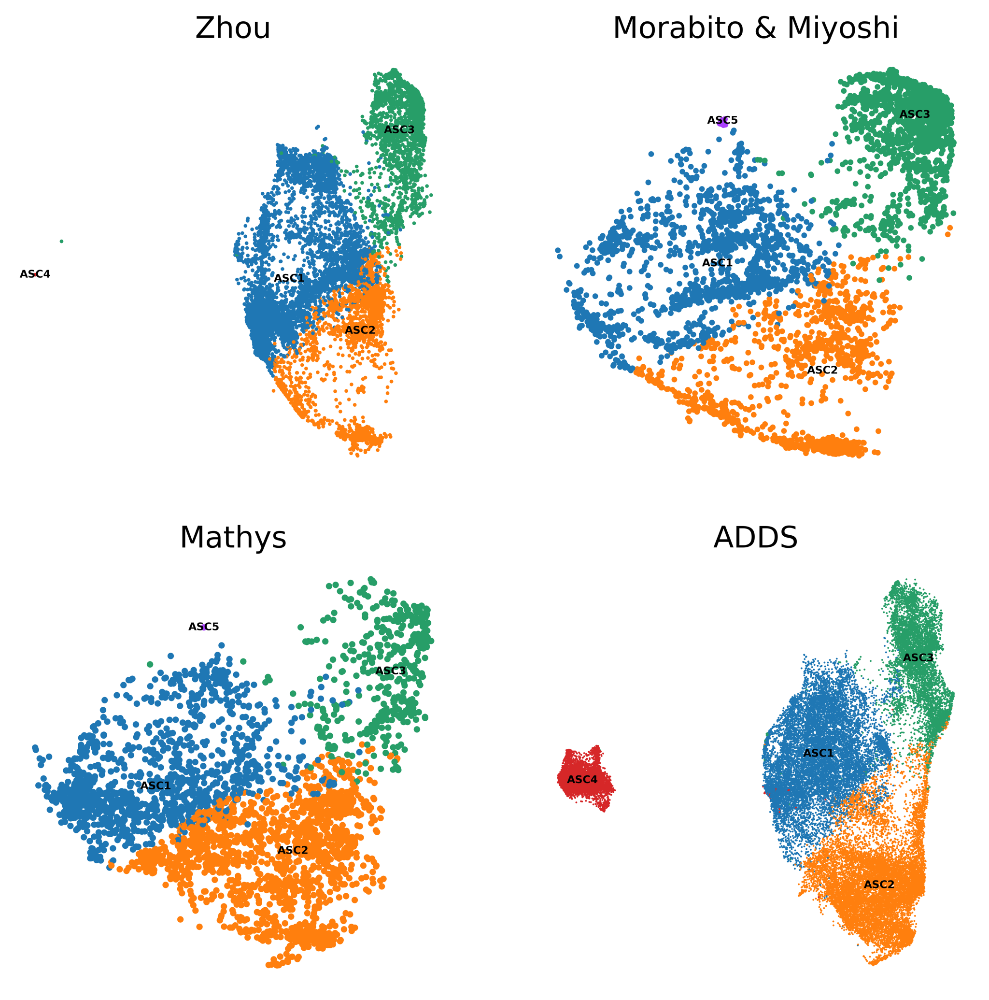

In [50]:
sc.settings.set_figure_params(dpi=300, figsize=(8,8), facecolor='white')


fig, axs = plt.subplots(2, 2)


f1 = sc.pl.umap(
    adata_asc[adata_asc.obs.Study == 'Zhou_2020'],
    color=["annotation"],
    frameon=False,
    legend_fontsize=5,
    legend_loc='on data',
    title = 'Zhou',
    ax = axs[0,0],
    show=False
)

sc.pl.umap(
    adata_asc[adata_asc.obs.Study == 'Morabito'],
    color=["annotation"],
    frameon=False,
    legend_fontsize=5,
    legend_loc='on data',
    title = 'Morabito & Miyoshi',
    ax = axs[0,1],
    show=False

)

sc.pl.umap(
    adata_asc[adata_asc.obs.Study == 'Mathys_2019'],
    color=["annotation"],
    frameon=False,
    legend_fontsize=5,
    legend_loc='on data',
    title = 'Mathys',
    ax = axs[1,0],
    show=False
)

sc.pl.umap(
    adata_asc[adata_asc.obs.Study == 'ADDS'],
    color=["annotation"],
    frameon=False,
    legend_fontsize=5,
    legend_loc='on data',
    title = 'ADDS',
    ax = axs[1,1],
    show=False
)




         Falling back to preprocessing with `sc.pp.pca` and default params.
categories: ASC1, ASC2, ASC3, etc.
var_group_labels: Astrocyte


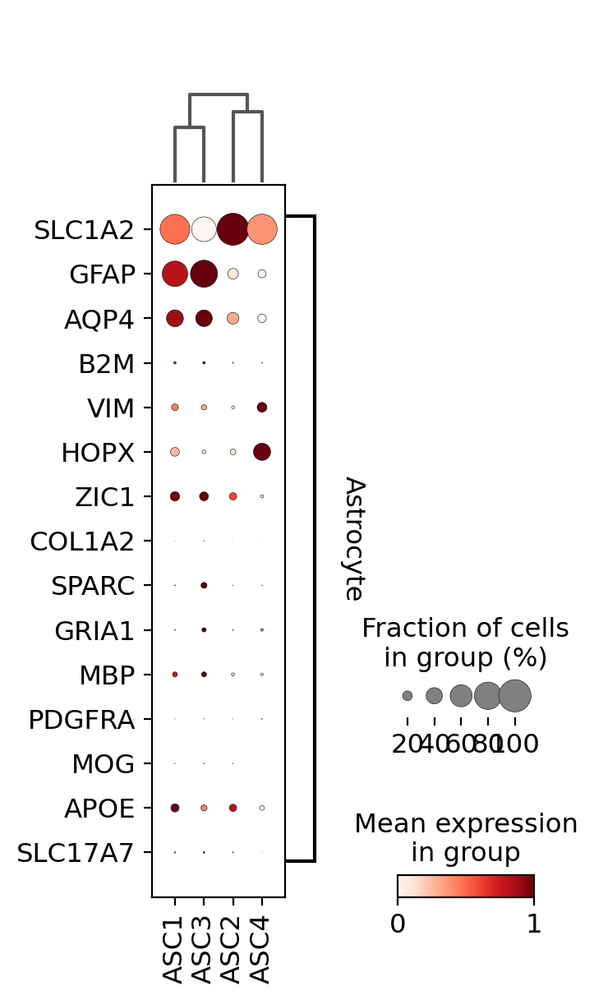

In [120]:
marker_dict = {
    'Astrocyte': [
        'SLC1A2', 'GFAP', 'AQP4', 'B2M', 'VIM', 
        'HOPX', 'ZIC1', 'COL1A2', # Hasel et al cluster 9
        'SPARC',  'GRIA1', 'MBP', 'PDGFRA', 'MOG',
        'APOE', 'SLC17A7'
    ],
}

sc.set_figure_params(dpi=100)
sc.pl.dotplot(
    adata_asc[adata_asc.obs.Study == 'ADDS'], 
    marker_dict, 
    'annotation', 
    dendrogram=True, 
    use_raw=False, 
    standard_scale='var', 
    swap_axes=True
)


/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scvi-env/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


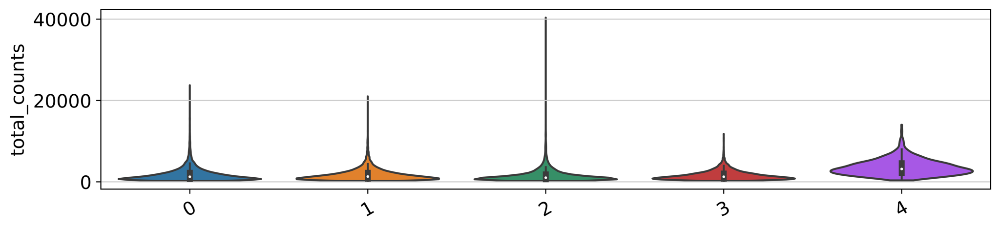

/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scvi-env/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


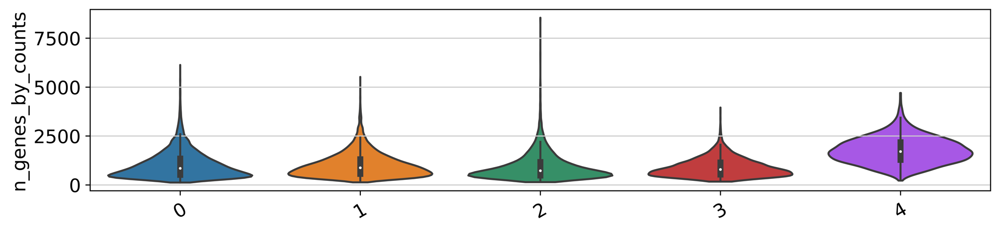

/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scvi-env/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


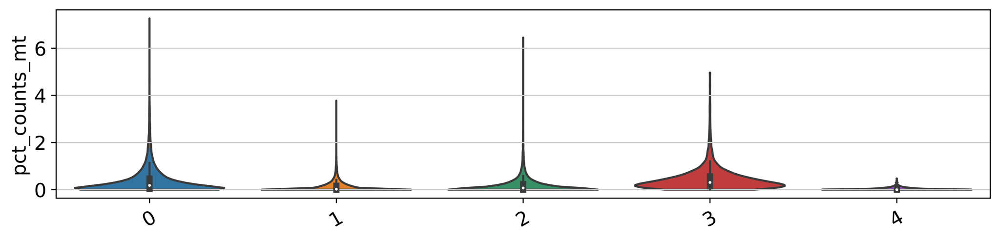

/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scvi-env/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


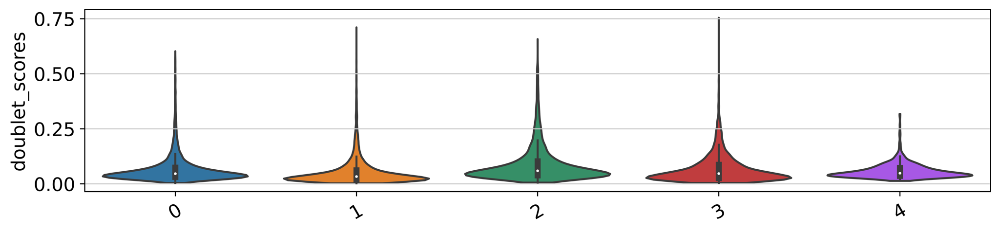

In [40]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(10,2.5), facecolor='white')
sc.pl.violin(adata_asc[adata_asc.obs.Study == 'ADDS'],[ 'total_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata_asc[adata_asc.obs.Study == 'ADDS'],[ 'n_genes_by_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata_asc[adata_asc.obs.Study == 'ADDS'],[ 'pct_counts_mt'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata_asc[adata_asc.obs.Study == 'ADDS'],[ 'doublet_scores'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)


In [55]:
adata_asc.obs.leiden.value_counts()

0    22440
1    18977
2    10816
3     5247
4       67
Name: leiden, dtype: int64

<AxesSubplot:xlabel='UMAP_1', ylabel='UMAP_2'>

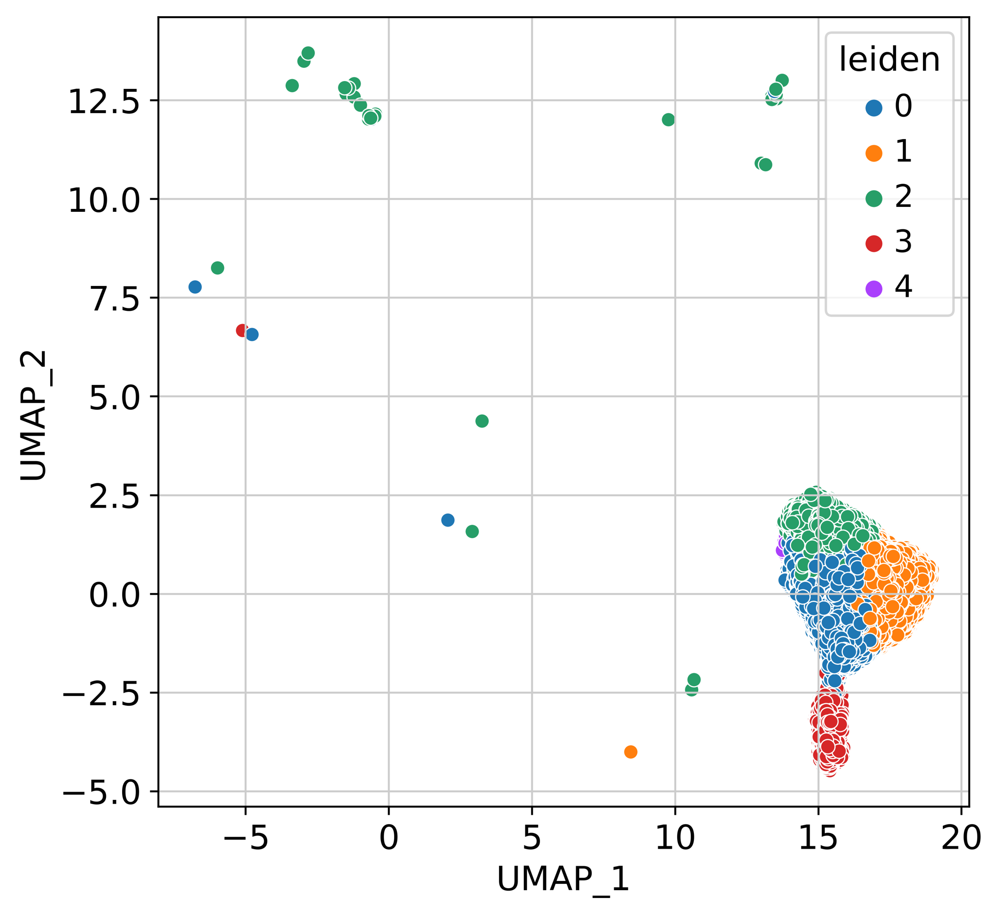

In [56]:
sc.settings.set_figure_params(dpi=300, figsize=(6,6), facecolor='white')

sns.scatterplot(
    data = adata_asc.obs,
    x = 'UMAP_1',
    y = 'UMAP_2',
    hue = 'leiden'
)

In [57]:
adata_asc = adata_asc[adata_asc.obs.annotation != 'ASC5'].copy()

In [58]:
adata_asc.obs['UMAP_sub_1'] = adata_asc.obsm['X_umap'][:,0]
adata_asc.obs['UMAP_sub_2'] = adata_asc.obsm['X_umap'][:,1]
adata_asc.obs.to_csv('{}ADDS_ASC_subcluster_obs.tsv'.format(data_dir), sep='\t')

## MG subclustering

In [59]:
adata_mg = adata[adata.obs.cell_identity == 'MG'].copy()
adata_mg = adata_mg[adata_mg.obs.cell_type == 'MG'].copy()

In [60]:
# use scVI latent space for UMAP generation
sc.pp.neighbors(adata_mg, use_rep="X_scANVI", metric='cosine', n_neighbors=15)
sc.tl.umap(adata_mg, min_dist=0.2)


In [79]:
sc.tl.leiden(adata_mg, resolution = 0.2)
sc.tl.dendrogram(adata_mg, groupby="leiden", use_rep="X_scANVI")

In [80]:
# change annotaiton name
adata_mg.obs['annotation'] = ['MG' + str(int(x) + 1) for x in adata_mg.obs.leiden.to_list()]

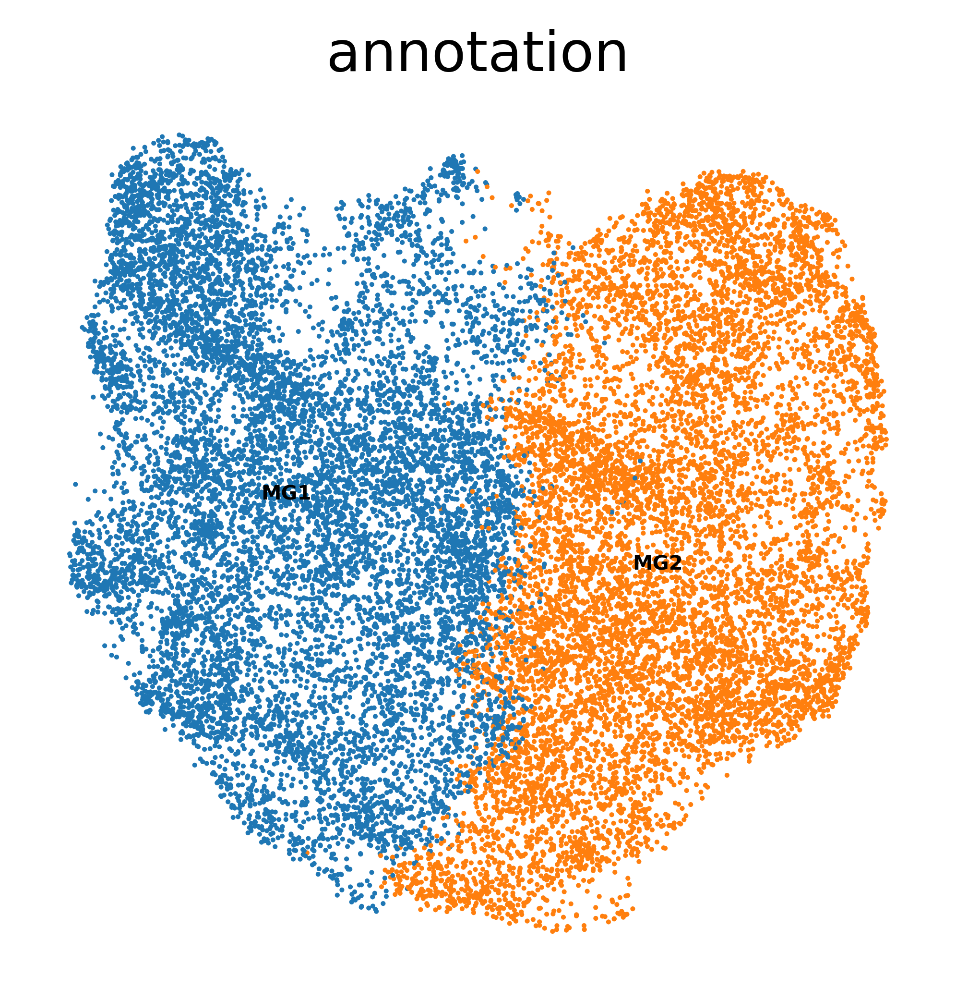

In [81]:
sc.settings.set_figure_params(dpi=300, figsize=(4,4), facecolor='white')
sc.pl.umap(
    adata_mg,
    color=["annotation"],
    frameon=False, 
    legend_fontsize=5, 
    legend_loc='on data', 
)


<AxesSubplot:title={'center':'ADDS'}, xlabel='UMAP1', ylabel='UMAP2'>

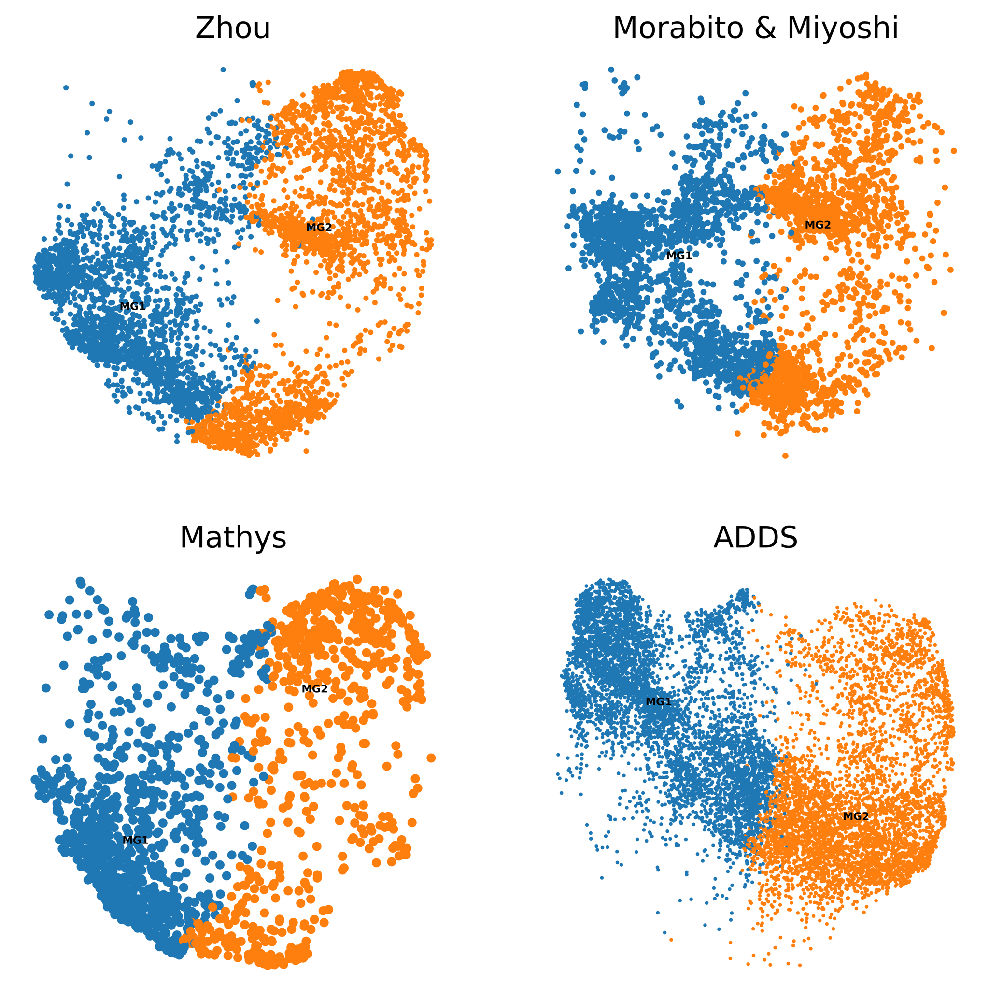

In [64]:
sc.settings.set_figure_params(dpi=300, figsize=(8,8), facecolor='white')


fig, axs = plt.subplots(2, 2)


f1 = sc.pl.umap(
    adata_mg[adata_mg.obs.Study == 'Zhou_2020'],
    color=["annotation"],
    frameon=False,
    legend_fontsize=5,
    legend_loc='on data',
    title = 'Zhou',
    ax = axs[0,0],
    show=False
)

sc.pl.umap(
    adata_mg[adata_mg.obs.Study == 'Morabito'],
    color=["annotation"],
    frameon=False,
    legend_fontsize=5,
    legend_loc='on data',
    title = 'Morabito & Miyoshi',
    ax = axs[0,1],
    show=False

)

sc.pl.umap(
    adata_mg[adata_mg.obs.Study == 'Mathys_2019'],
    color=["annotation"],
    frameon=False,
    legend_fontsize=5,
    legend_loc='on data',
    title = 'Mathys',
    ax = axs[1,0],
    show=False
)

sc.pl.umap(
    adata_mg[adata_mg.obs.Study == 'ADDS'],
    color=["annotation"],
    frameon=False,
    legend_fontsize=5,
    legend_loc='on data',
    title = 'ADDS',
    ax = axs[1,1],
    show=False
)




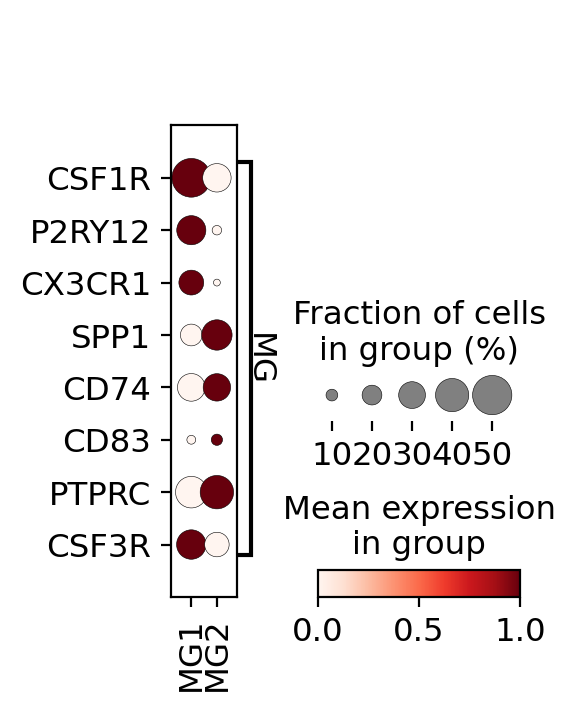

In [65]:
marker_dict = {
    'MG': [
        'CSF1R', 'P2RY12', 'CX3CR1', 'SPP1',
        'CD74', 'CD83', 'PTPRC', 'CSF3R'
    ],
}

sc.set_figure_params(dpi=100)
sc.pl.dotplot(
    adata_mg[adata_mg.obs.Study == 'ADDS'], 
    marker_dict, 
    'annotation', 
    dendrogram=True, 
    use_raw=False, 
    standard_scale='var', 
    swap_axes=True
)


<AxesSubplot:xlabel='UMAP_1', ylabel='UMAP_2'>

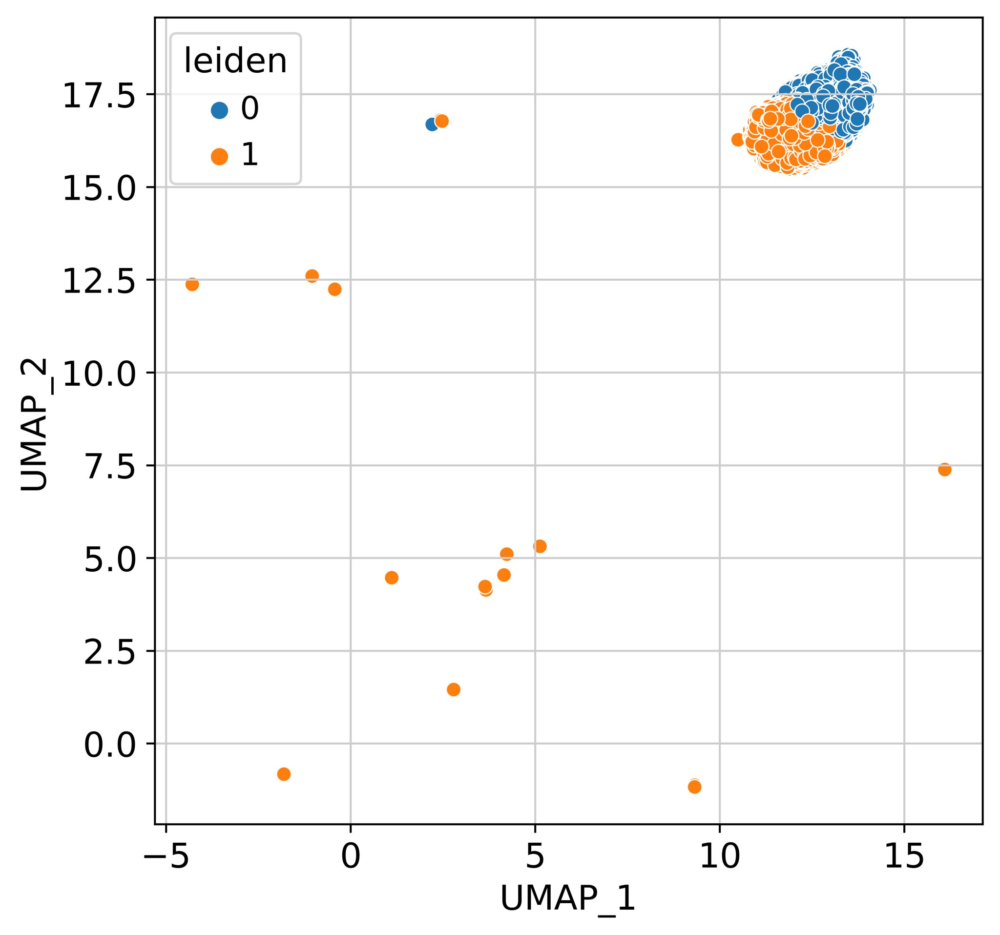

In [82]:
sc.settings.set_figure_params(dpi=300, figsize=(6,6), facecolor='white')

sns.scatterplot(
    data = adata_mg.obs,
    x = 'UMAP_1',
    y = 'UMAP_2',
    hue = 'leiden'
)

In [83]:
adata_mg.obs['UMAP_sub_1'] = adata_mg.obsm['X_umap'][:,0]
adata_mg.obs['UMAP_sub_2'] = adata_mg.obsm['X_umap'][:,1]
adata_mg.obs.to_csv('{}ADDS_MG_subcluster_obs.tsv'.format(data_dir), sep='\t')


## Merge subcluster info with main anndata object

In [84]:
# remove the vascular clusters which were doublets
adata = adata[adata.obs.index.isin(adata_odc.obs.index) | ~adata.obs.cell_type.isin(["ODC"])].copy()
adata = adata[adata.obs.index.isin(adata_asc.obs.index) | ~adata.obs.cell_identity.isin(["ASC"])].copy()
adata = adata[adata.obs.index.isin(adata_opc.obs.index) | ~adata.obs.cell_identity.isin(["OPC"])].copy()
adata = adata[adata.obs.index.isin(adata_mg.obs.index) | ~adata.obs.cell_identity.isin(["MG"])].copy()

In [85]:
cols_to_keep = adata_opc.obs.drop(labels=['UMAP_sub_1', 'UMAP_sub_2'], axis=1).columns
df_list = [
    adata_opc.obs[cols_to_keep],
    adata_odc.obs[cols_to_keep],
    adata_asc.obs[cols_to_keep],
    adata_mg.obs[cols_to_keep],
]

df = df_list[0].append(df_list[1:], ignore_index=False)
df.shape

(254058, 28)

In [86]:
temp = adata[~adata.obs.index.isin(df.index)].obs
temp = temp.append(df)

# re-order based on anndata:
temp = temp.loc[adata.obs.index.to_list()]

In [87]:
temp.shape

(585563, 28)

In [88]:
adata.shape

(585563, 3000)

In [89]:
# update cell_identity columns
anno = temp.annotation.to_list()
cell_id = temp.cell_identity.to_list()

adata.obs.cell_identity = [anno[i] if cell_id[i] in ['OPC', 'ODC', 'ASC', 'MG'] else cell_id[i] for i in range(adata.shape[0])]

In [97]:
tmp = adata.obs.cell_identity.unique()[adata.obs.cell_identity.value_counts() > 100].to_list()

In [100]:
adata = adata[adata.obs.cell_identity.isin(tmp)]

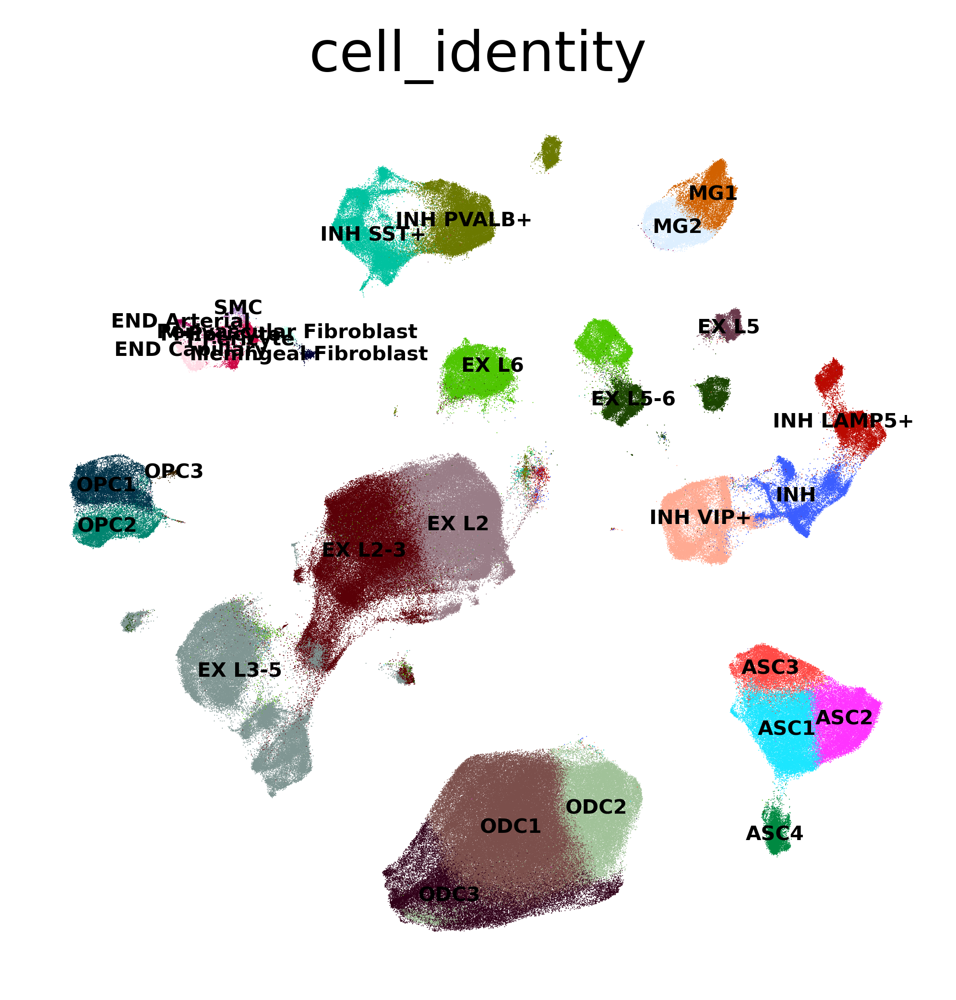

In [101]:
sc.settings.set_figure_params(dpi=300, figsize=(4,4), facecolor='white')
sc.pl.umap(
    adata,
    color=["cell_identity"],
    frameon=False, 
    legend_fontsize=5, 
    legend_loc='on data', 
)


In [103]:
sc.tl.paga(adata, groups='cell_identity')

/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scvi-env/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


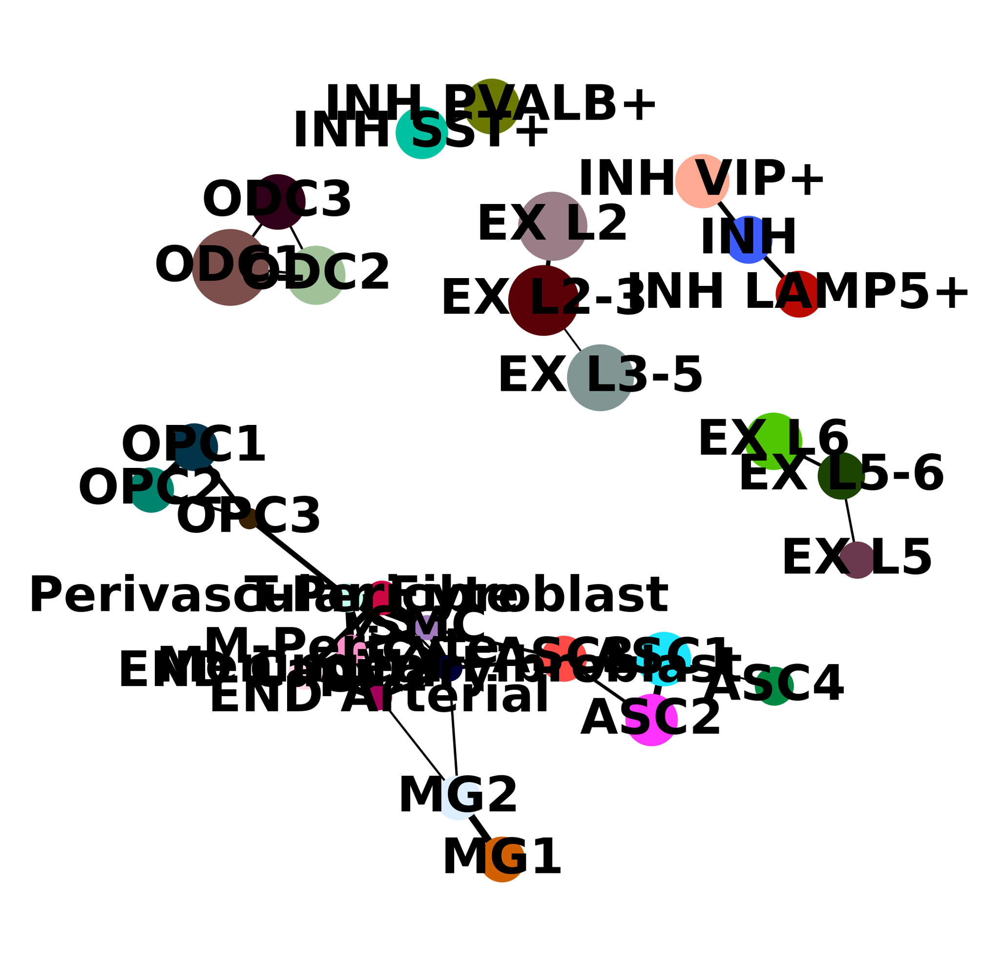

In [104]:
sc.settings.set_figure_params(dpi=300, figsize=(4,4), facecolor='white')
sc.pl.paga(
    adata, threshold=0.25, title='', edge_width_scale=0.25,
    frameon=False, save=True
)

In [105]:
# use scVI latent space for UMAP generation
sc.tl.umap(adata, min_dist=0.2, init_pos='paga')



In [112]:
# add umap to obs table
adata.obs['UMAP_1'] = adata.obsm['X_umap'][:,0]
adata.obs['UMAP_2'] = adata.obsm['X_umap'][:,1]

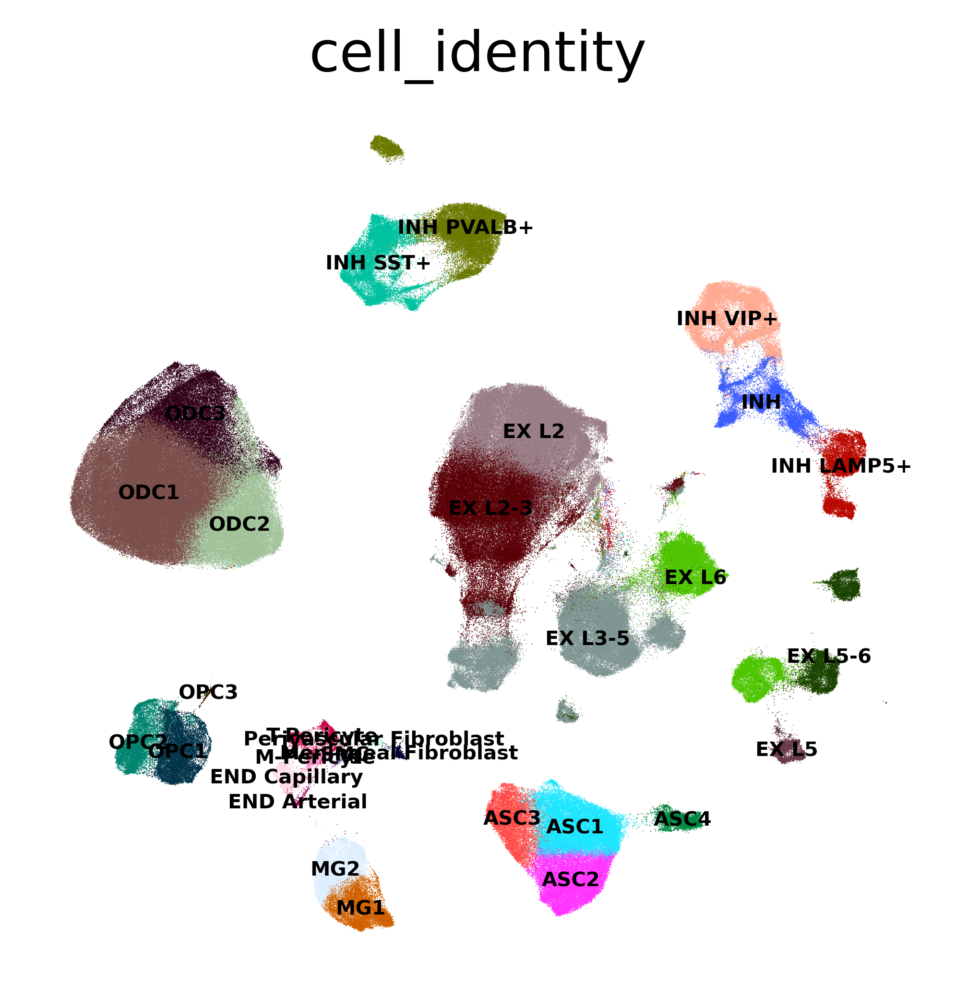

In [106]:
sc.settings.set_figure_params(dpi=300, figsize=(4,4), facecolor='white')
sc.pl.umap(
    adata,
    color=["cell_identity"],
    frameon=False, 
    legend_fontsize=5, 
    legend_loc='on data', 
)


<AxesSubplot:title={'center':'ADDS'}, xlabel='UMAP1', ylabel='UMAP2'>

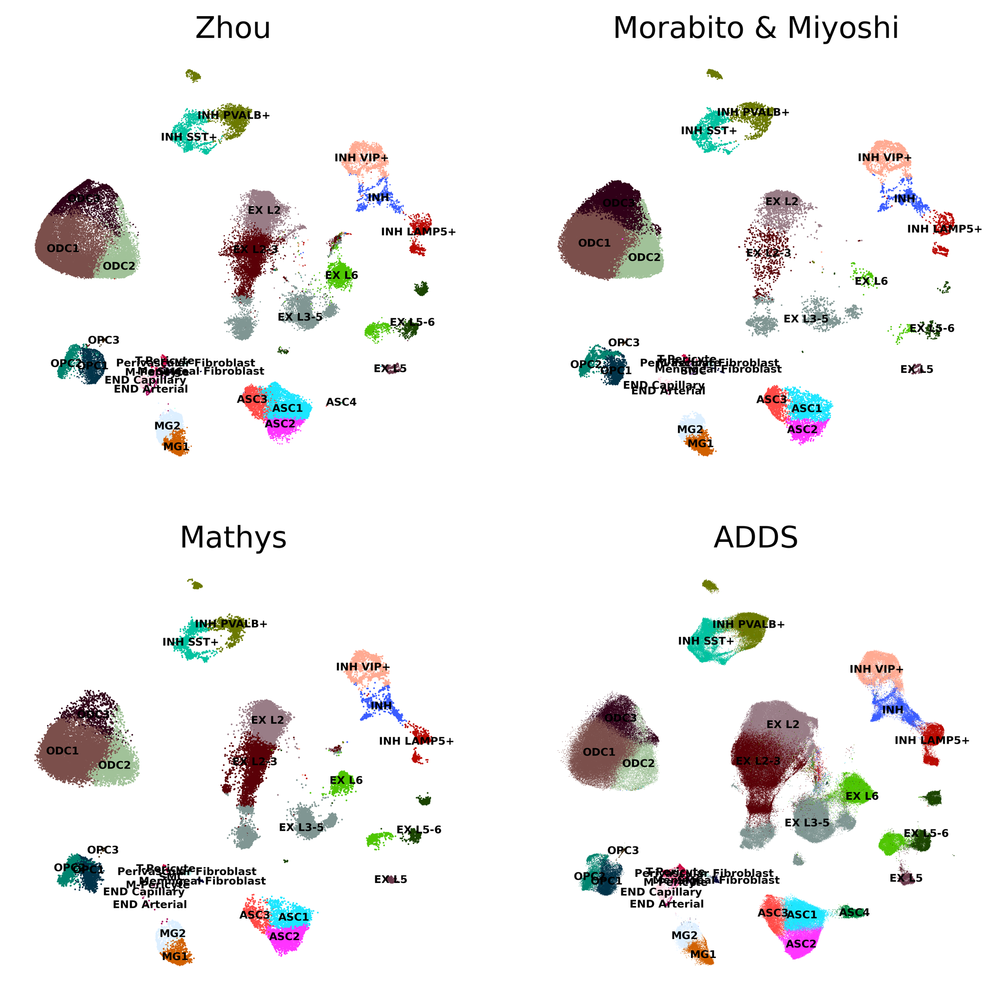

In [107]:
sc.settings.set_figure_params(dpi=300, figsize=(8,8), facecolor='white')


fig, axs = plt.subplots(2, 2)


f1 = sc.pl.umap(
    adata[adata.obs.Study == 'Zhou_2020'],
    color=["cell_identity"],
    frameon=False,
    legend_fontsize=5,
    legend_loc='on data',
    title = 'Zhou',
    ax = axs[0,0],
    show=False
)

sc.pl.umap(
    adata[adata.obs.Study == 'Morabito'],
    color=["cell_identity"],
    frameon=False,
    legend_fontsize=5,
    legend_loc='on data',
    title = 'Morabito & Miyoshi',
    ax = axs[0,1],
    show=False

)

sc.pl.umap(
    adata[adata.obs.Study == 'Mathys_2019'],
    color=["cell_identity"],
    frameon=False,
    legend_fontsize=5,
    legend_loc='on data',
    title = 'Mathys',
    ax = axs[1,0],
    show=False
)

sc.pl.umap(
    adata[adata.obs.Study == 'ADDS'],
    color=["cell_identity"],
    frameon=False,
    legend_fontsize=5,
    legend_loc='on data',
    title = 'ADDS',
    ax = axs[1,1],
    show=False
)




## save

In [113]:
adata.write('{}ADDS_subclusters_final.h5ad'.format(data_dir))

In [124]:
# write the metadata:
adata.obs.to_csv('{}ADDS_subclusters_final.tsv'.format(data_dir), sep='\t')

In [125]:
adata.var.to_csv('{}ADDS_subclusters_var.tsv'.format(data_dir), sep='\t')

In [8]:
# save the scanvi

pd.DataFrame(adata.obsm['X_scANVI']).to_csv('{}/ADDS_AD_scANVI.csv'.format(data_dir))
